# Annotations using clustering for cells for prostate_s0

In [1]:
slide_id = "prostate_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_prostate_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 49976, 25002), (3, 24988, 12501)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 13) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (184853, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (184853, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (184853, 5006)
      └── 'table_nuclei': AnnData (184853, 8169)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 184853 × 5006
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,nucleus_count,segmentation_method,region,z_level
1,aaaaaaaa-1,341,0,0,0,0,1,342,111.535942,50.484689,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
2,aaaaaaab-1,14,0,0,0,0,0,14,108.600785,18.875313,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
3,aaaaaaac-1,45,0,0,0,0,0,45,56.309846,11.289063,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
4,aaaaaaad-1,99,0,0,0,0,0,99,41.543752,19.642969,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
7,aaaaaaae-1,40,0,0,0,0,0,40,26.100313,12.688907,1.0,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
192995,aaacncba-1,65,0,0,0,0,0,65,37.570001,13.501719,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,9.0
192996,aaacncbb-1,30,0,0,0,0,0,30,9.573125,5.192969,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,10.0
192997,aaacncbc-1,139,0,0,0,0,0,139,99.117972,5.147813,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,10.0
192998,aaacncbd-1,8,0,0,0,0,0,8,147.344849,14.856407,1.0,Segmented by nucleus expansion of 5.0µm,cell_labels,9.0


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
A2ML1,ENSG00000166535,Gene Expression,Unknown
AAMP,ENSG00000127837,Gene Expression,Unknown
AAR2,ENSG00000131043,Gene Expression,Unknown
AARSD1,ENSG00000266967,Gene Expression,Unknown
ABAT,ENSG00000183044,Gene Expression,Unknown
...,...,...,...
ZSCAN26,ENSG00000197062,Gene Expression,Unknown
ZSWIM6,ENSG00000130449,Gene Expression,Unknown
ZUP1,ENSG00000153975,Gene Expression,Unknown
ZYG11B,ENSG00000162378,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 164151 × 8169
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,48.430362,Endothelial,173,6,7,7,7,Endothelial,Angiogenesis_endothelial_cell,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,10.024697,B_cell,26,1,3,4,4,Smooth_muscle,Smooth_muscle,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,18.130185,T_cell,99,4,9,9,9,T,T,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,11.311480,Fibroblast,43,1,4,3,3,Fibroblast,CAF,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,23.368346,T_cell,164,4,9,9,9,T,T,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaacncao-1,nucleus_boundaries,morpho,aaacncao-1,12.937722,Myeloid,65,0,2,2,2,Epithelial,Prostate_epithelial_cancer_cell,cancer_cell
aaacncba-1,nucleus_boundaries,morpho,aaacncba-1,11.650370,Fibroblast,19,2,3,4,4,Smooth_muscle,Smooth_muscle,normal_cell
aaacncbb-1,nucleus_boundaries,morpho,aaacncbb-1,4.403098,Smooth_muscle,14,1,3,4,4,Smooth_muscle,Smooth_muscle,normal_cell
aaacncbc-1,nucleus_boundaries,morpho,aaacncbc-1,4.335010,Smooth_muscle,15,1,1,0,0,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell


In [9]:
adata_nuclei.var

,mean,std
A2ML1,0.007938,0.185604
AAMP,0.157283,0.802594
AAR2,0.042399,0.429905
AARSD1,0.077888,0.563379
ABAT,0.114361,0.679466
...,...,...
ZSCAN26,0.045916,0.445086
ZSWIM6,0.038005,0.403055
ZUP1,0.047327,0.447816
ZYG11B,0.046688,0.446143


## 2. Preprocessing

<Axes: >

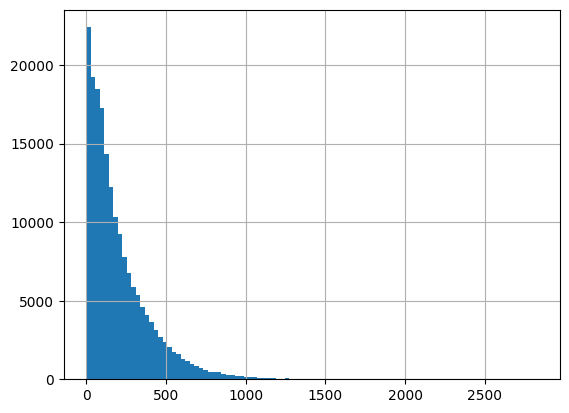

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

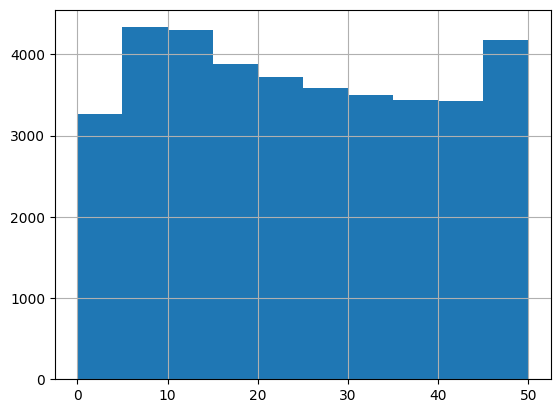

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 15775
Percentage of cells with less than 20 transcripts: 8.53%
-----
Number of cells with less than 15 transcripts: 11894
Percentage of cells with less than 15 transcripts: 6.43%
-----
Number of cells with less than 10 transcripts: 7592
Percentage of cells with less than 10 transcripts: 4.11%
-----
Number total of cells: 184853


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

176359


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


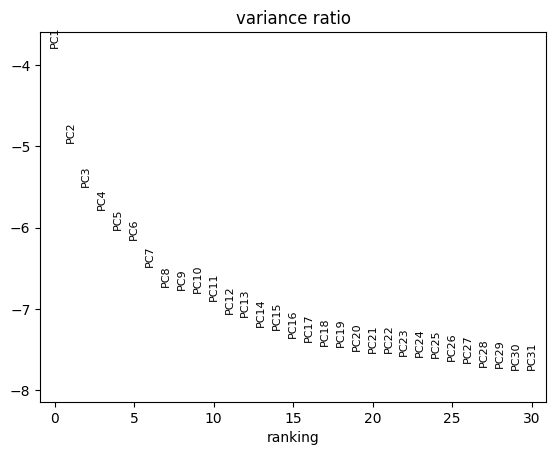

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 176359 × 5006
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'genomic_control_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'nucleus_count', 'segmentation_method', 'region', 'z_level'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_5897/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


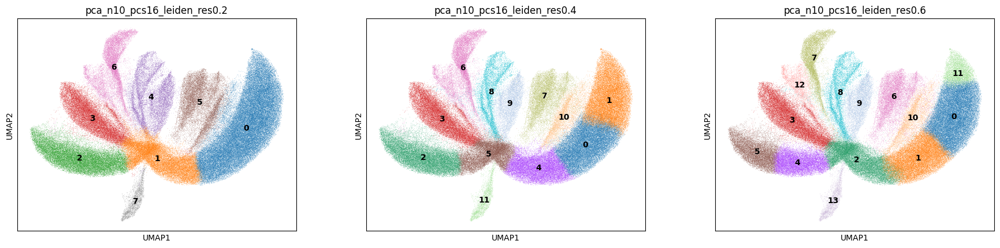

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].unique()

['7', '2', '4', '9', '3', ..., '1', '13', '5', '10', '12']
Length: 14
Categories (14, object): ['0', '1', '2', '3', ..., '10', '11', '12', '13']

In [24]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['11']), 'refine_res'] = '11'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['12']), 'refine_res'] = '12'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.6'].isin(['13']), 'refine_res'] = '13'

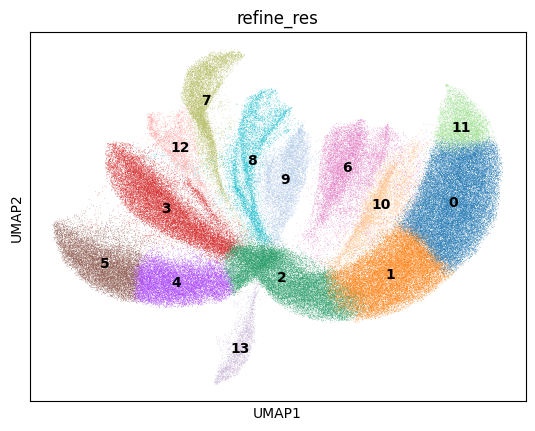

In [25]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [26]:
clustering_label = 'refine_res'

In [27]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

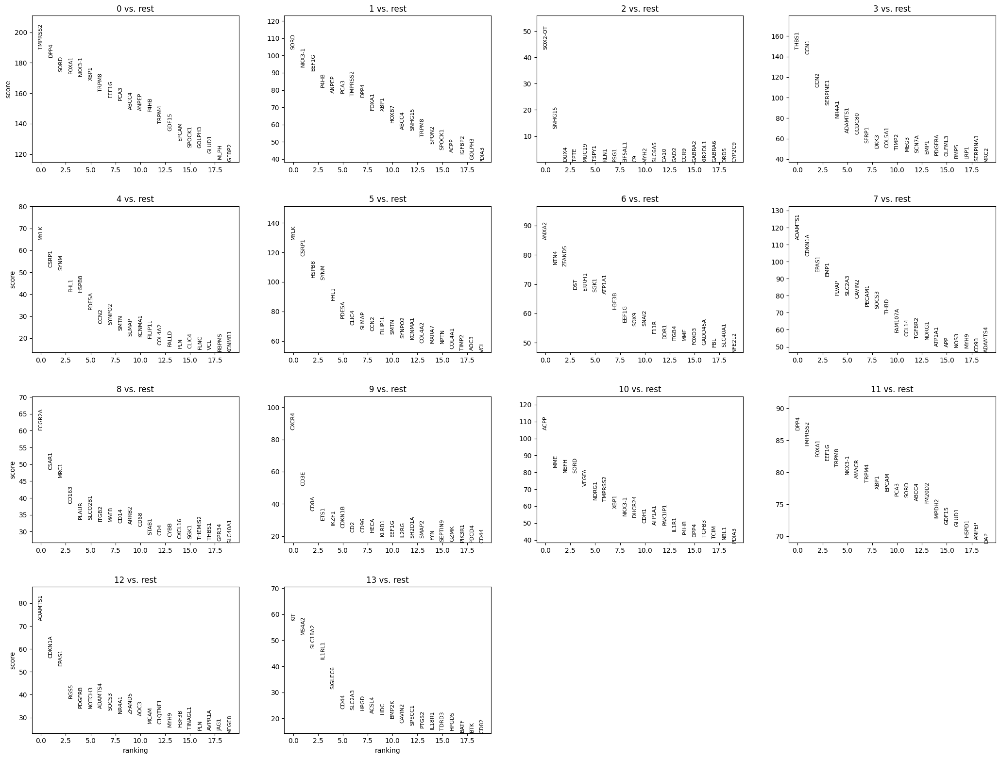

In [28]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [42]:
cluster_id = '0'

In [32]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Prostate_epithelial_cancer_cell,cancer_cell,97.9
1,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,1.9
2,NA,NA,NA,0.1
3,Fibroblast,CAF,normal_cell,0.0
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.0


In [33]:
top_ranked_genes[cluster_id]

0    TMPRSS2
1       DPP4
2       SORD
3      FOXA1
4     NKX3-1
5       XBP1
6      TRPM8
Name: 0, dtype: object

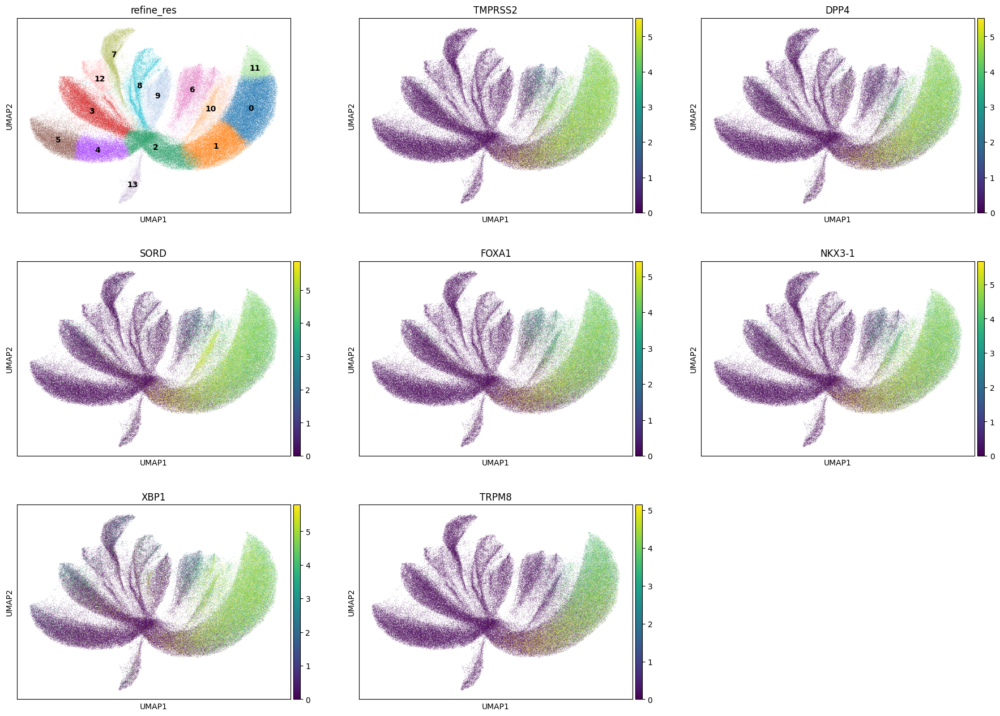

In [34]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 31607
Percentage of cells in cluster 0: 17.9


In [43]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Luminal_epithelial_cell'

### 5.2. Cluster 1

In [44]:
cluster_id = '1'

In [38]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Prostate_epithelial_cancer_cell,cancer_cell,61.4
1,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,35.5
2,NA,NA,NA,2.0
3,Fibroblast,CAF,normal_cell,0.6
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.2


In [39]:
top_ranked_genes[cluster_id]

0       SORD
1     NKX3-1
2      EEF1G
3       P4HB
4      ANPEP
5       PCA3
6    TMPRSS2
Name: 1, dtype: object

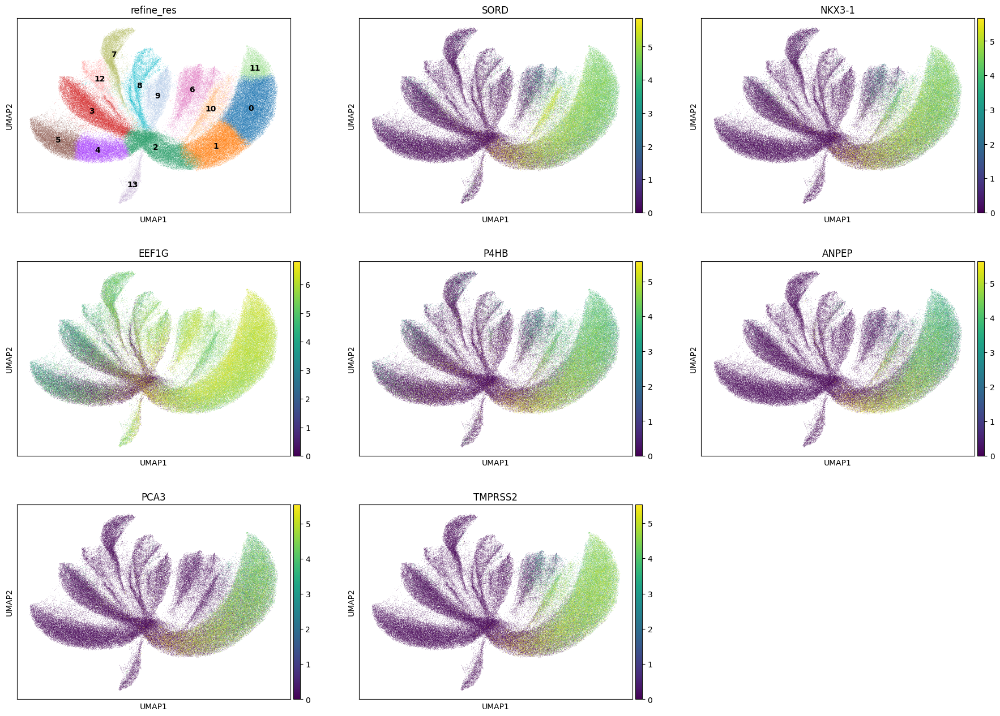

In [40]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 22986
Percentage of cells in cluster 1: 13.0


In [45]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Luminal_epithelial_cell'

### 5.3. Cluster 2

In [46]:
cluster_id = '2'

In [47]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,62.5
1,NA,NA,NA,33.3
2,Epithelial,Prostate_epithelial_cancer_cell,cancer_cell,2.0
3,Smooth_muscle,Smooth_muscle,normal_cell,0.8
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.8


In [48]:
top_ranked_genes[cluster_id]

0    SOX2-OT
1     SNHG15
2       DUX4
3       TPTE
4      MUC19
5      TSPY1
6       RLN1
Name: 2, dtype: object

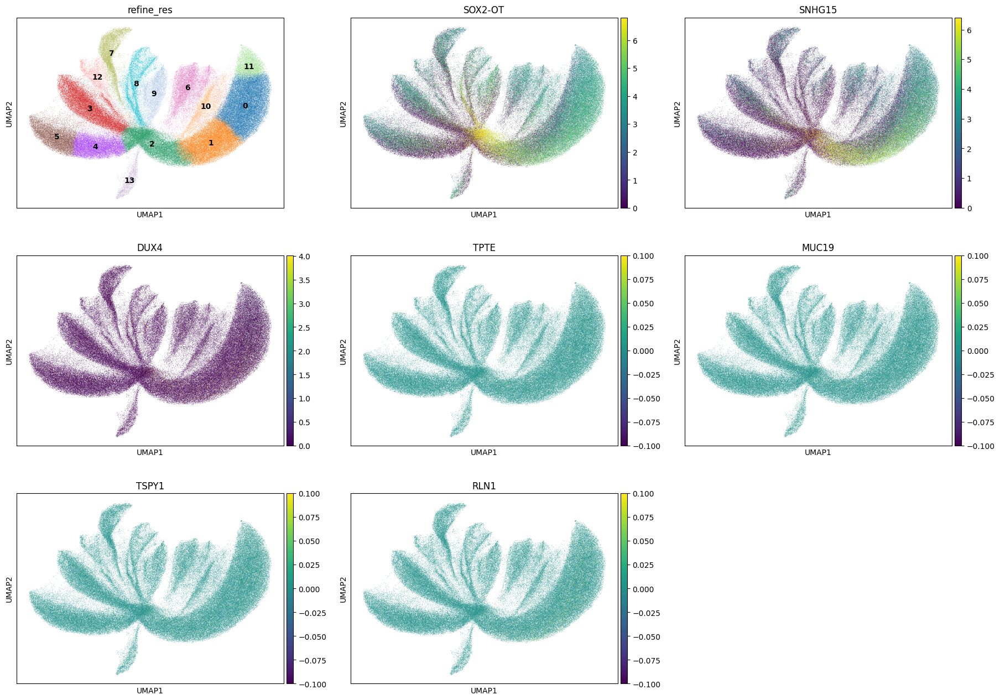

In [49]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [50]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 21088
Percentage of cells in cluster 2: 12.0


In [51]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Stem_like_cell'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Stem_like_cell'

### 5.4. Cluster 3

In [52]:
cluster_id = '3'

In [53]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,CAF,normal_cell,73.7
1,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,16.1
2,NA,NA,NA,5.7
3,Smooth_muscle,Smooth_muscle,normal_cell,2.3
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.6


In [54]:
top_ranked_genes[cluster_id]

0       THBS1
1        CCN1
2        CCN2
3    SERPINE1
4       NR4A1
5     ADAMTS1
6      CCDC80
Name: 3, dtype: object

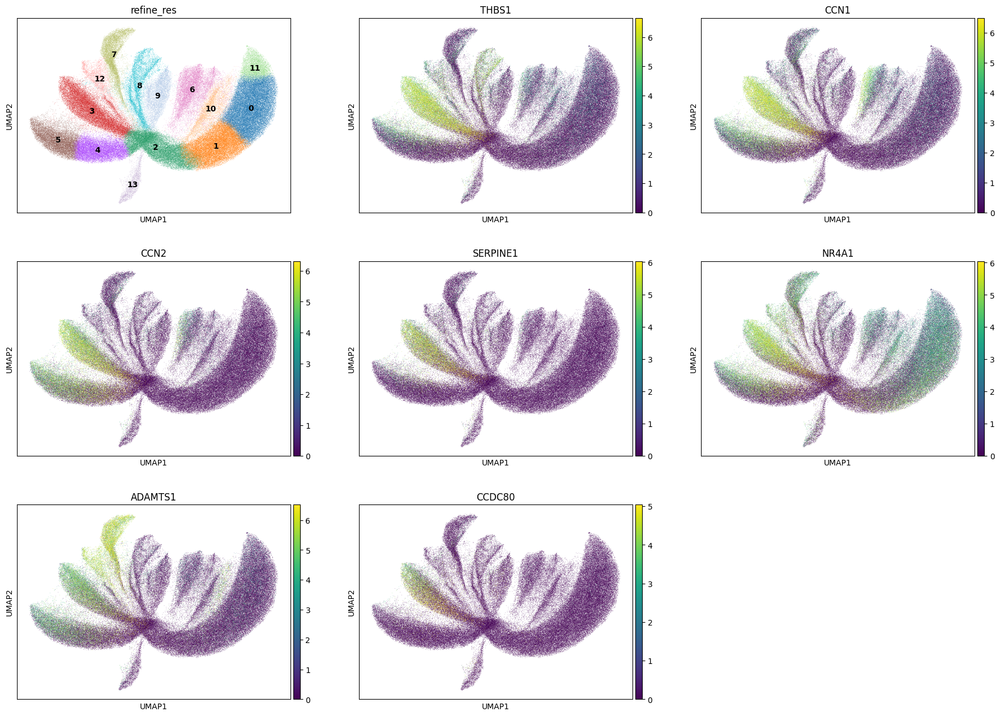

In [55]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [56]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 20946
Percentage of cells in cluster 3: 11.9


In [57]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'CAF'

### 5.5. Cluster 4

In [58]:
cluster_id = '4'

In [59]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Smooth_muscle,Smooth_muscle,normal_cell,71.8
1,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,14.1
2,NA,NA,NA,12.6
3,Fibroblast,CAF,normal_cell,1.0
4,Pericyte,Pericyte,normal_cell,0.2


In [60]:
top_ranked_genes[cluster_id]

0     MYLK
1    CSRP1
2     SYNM
3     FHL1
4    HSPB8
5    PDE5A
6     CCN2
Name: 4, dtype: object

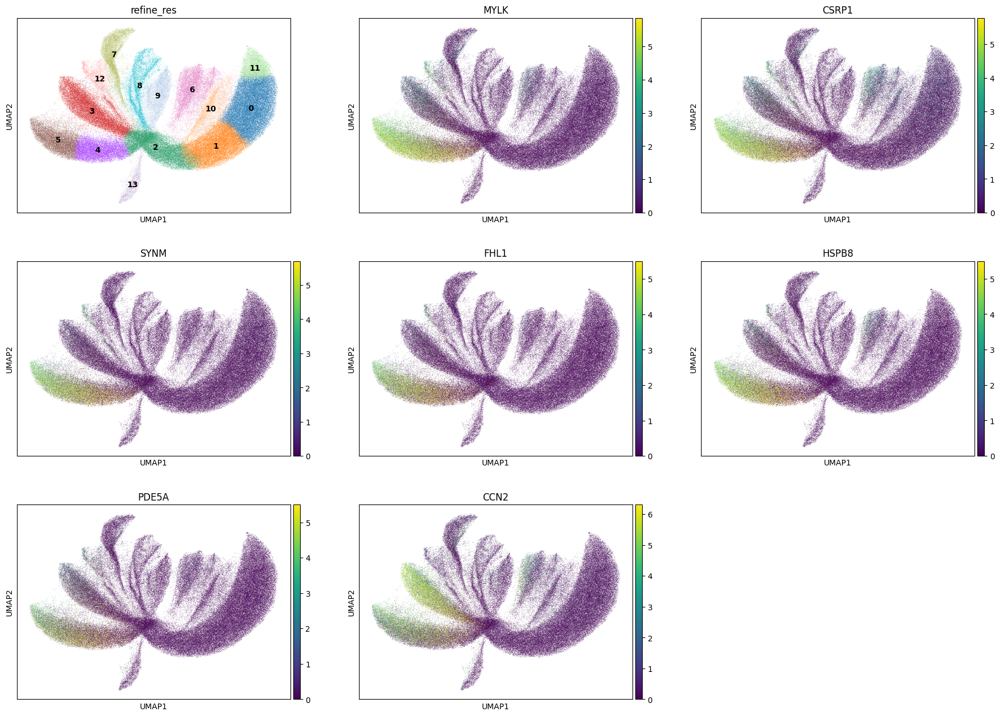

In [61]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [62]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 13685
Percentage of cells in cluster 4: 7.8


In [63]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.6. Cluster 5

In [64]:
cluster_id = '5'

In [65]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Smooth_muscle,Smooth_muscle,normal_cell,94.3
1,Fibroblast,CAF,normal_cell,2.5
2,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,2.0
3,NA,NA,NA,0.9
4,Pericyte,Pericyte,normal_cell,0.2


In [66]:
top_ranked_genes[cluster_id]

0     MYLK
1    CSRP1
2    HSPB8
3     SYNM
4     FHL1
5    PDE5A
6    CLIC4
Name: 5, dtype: object

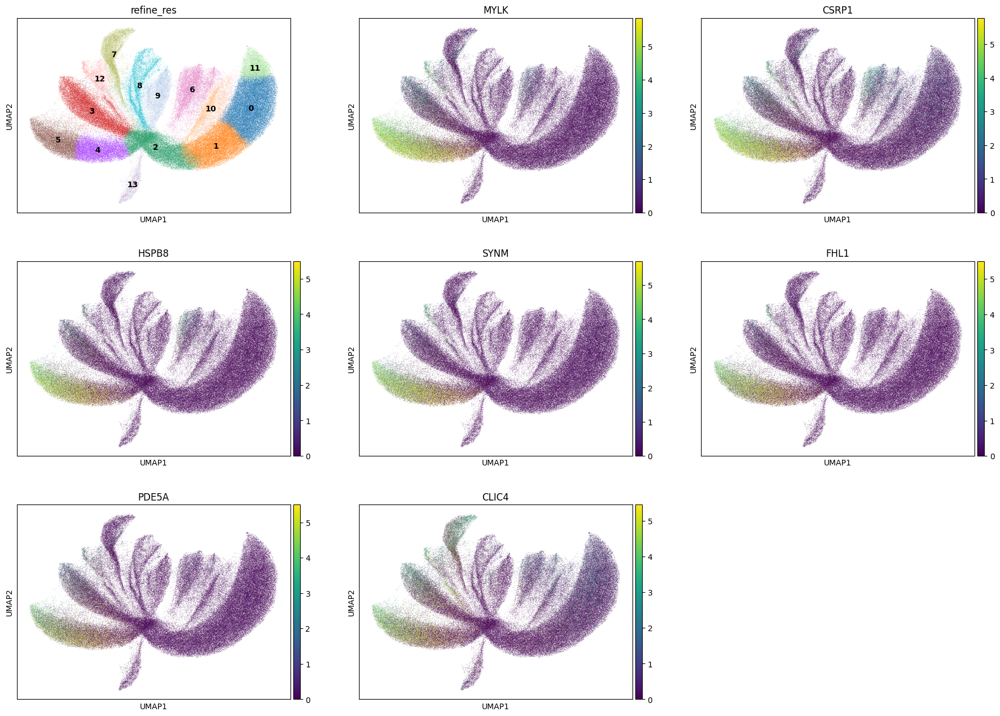

In [67]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [68]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 12381
Percentage of cells in cluster 5: 7.0


In [69]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Smooth_muscle'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Smooth_muscle'

### 5.7. Cluster 6

In [70]:
cluster_id = '6'

In [71]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Prostate_epithelial_cancer_cell,cancer_cell,94.4
1,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,3.9
2,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.5
3,Fibroblast,CAF,normal_cell,0.4
4,NA,NA,NA,0.3


In [72]:
top_ranked_genes[cluster_id]

0     ANXA2
1      NTN4
2    ZFAND5
3       DST
4    ERRFI1
5      SGK1
6    ATP1A1
Name: 6, dtype: object

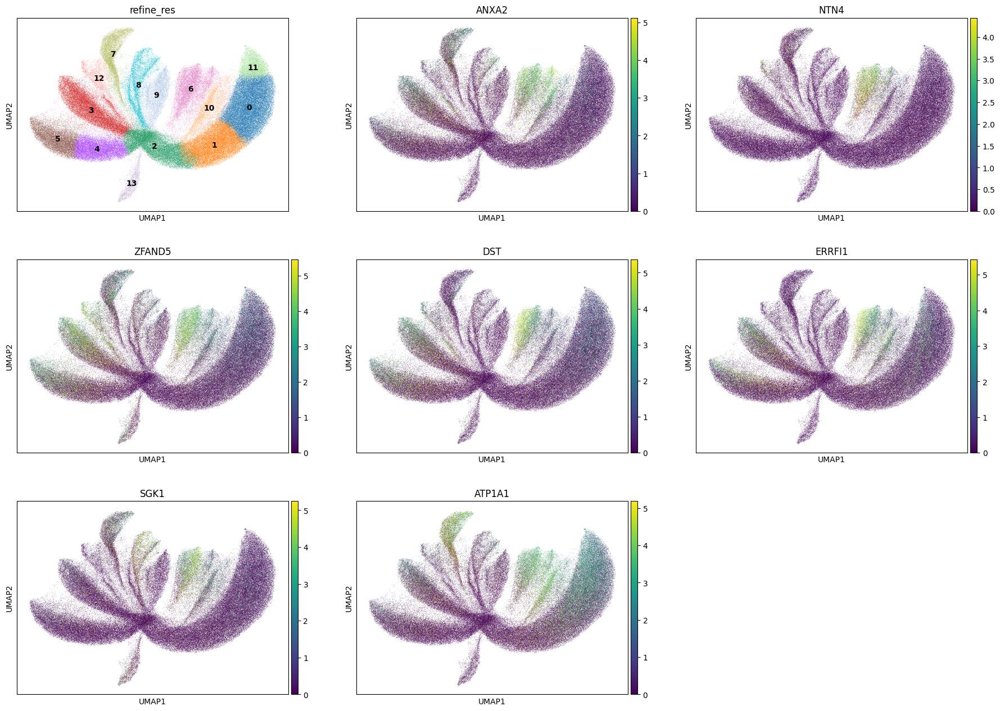

In [73]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [74]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 11163
Percentage of cells in cluster 6: 6.3


In [75]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Epithelial'

### 5.8. Cluster 7

In [76]:
cluster_id = '7'

In [77]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Angiogenesis_endothelial_cell,normal_cell,87.8
1,Pericyte,Pericyte,normal_cell,3.3
2,NA,NA,NA,3.0
3,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,2.8
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,1.8


In [78]:
top_ranked_genes[cluster_id]

0    ADAMTS1
1     CDKN1A
2      EPAS1
3       EMP1
4      PLVAP
5     SLC2A3
6     CAVIN2
Name: 7, dtype: object

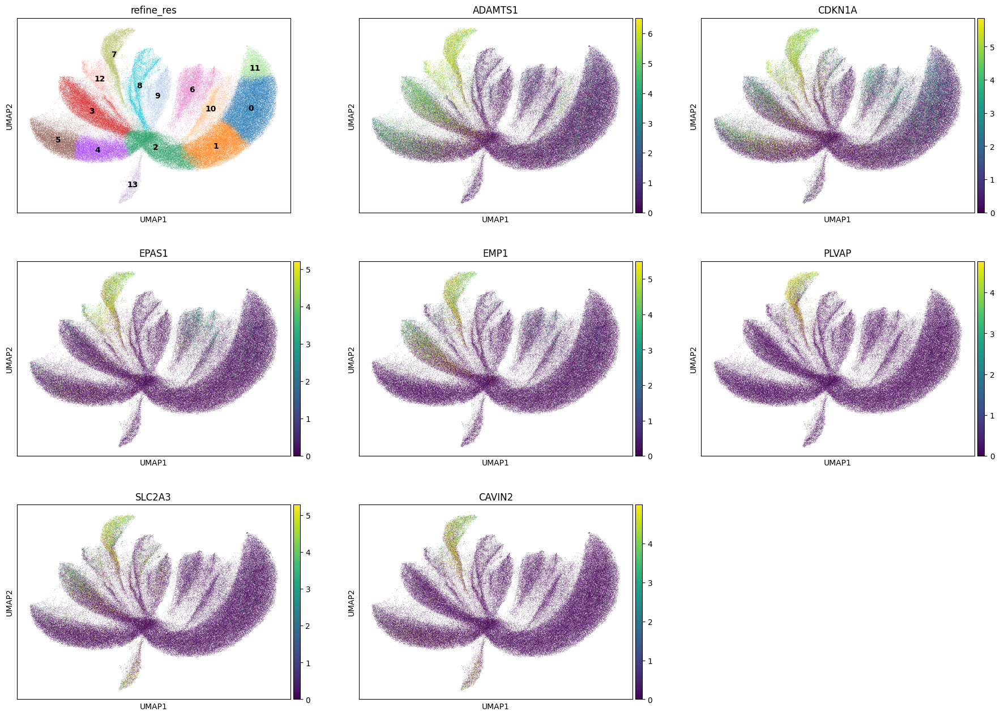

In [79]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [80]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 9291
Percentage of cells in cluster 7: 5.3


In [81]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

### 5.9. Cluster 8

In [82]:
cluster_id = '8'

In [83]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,77.9
1,NA,NA,NA,9.5
2,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,7.3
3,Fibroblast,CAF,normal_cell,2.6
4,T,T,normal_cell,0.9


In [84]:
top_ranked_genes[cluster_id]

0     FCGR2A
1      C5AR1
2       MRC1
3      CD163
4      PLAUR
5    SLCO2B1
6      ITGB2
Name: 8, dtype: object

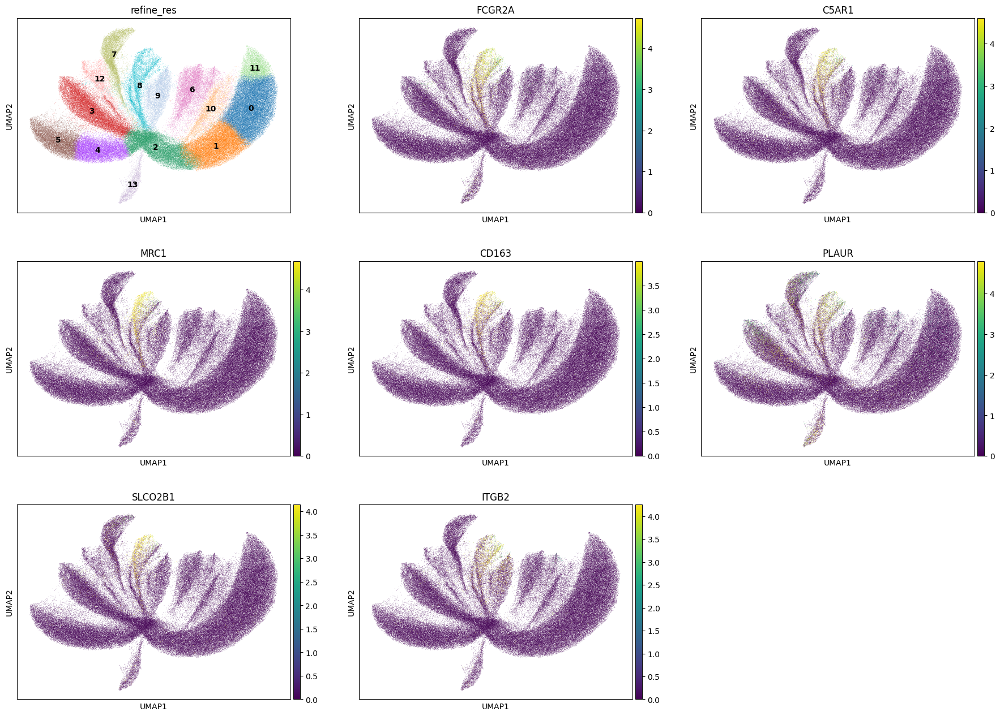

In [85]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [86]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 8461
Percentage of cells in cluster 8: 4.8


In [87]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.10. Cluster 9

In [88]:
cluster_id = '9'

In [89]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T,T,normal_cell,79.7
1,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,10.3
2,NA,NA,NA,5.9
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,2.1
4,Fibroblast,CAF,normal_cell,0.9


In [90]:
top_ranked_genes[cluster_id]

0     CXCR4
1      CD3E
2      CD8A
3      ETS1
4     IKZF1
5    CDKN1B
6       CD2
Name: 9, dtype: object

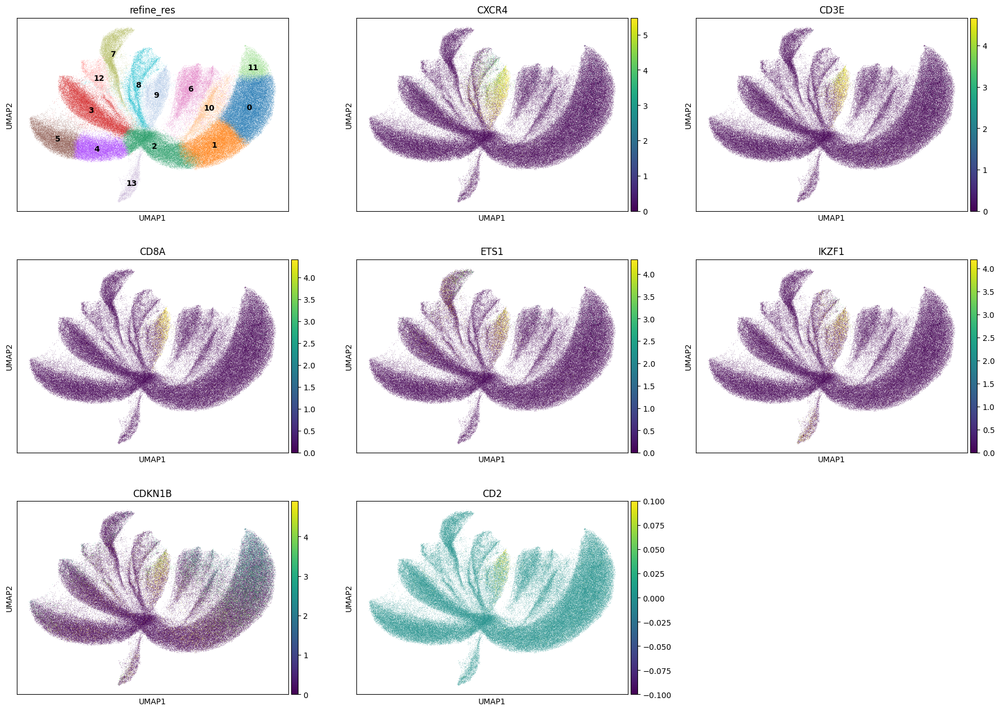

In [91]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [92]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 7242
Percentage of cells in cluster 9: 4.1


In [93]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T_CD8'

### 5.11. Cluster 10

In [94]:
cluster_id = '10'

In [95]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Prostate_epithelial_cancer_cell,cancer_cell,92.5
1,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,6.9
2,NA,NA,NA,0.4
3,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.1
4,T,T,normal_cell,0.1


In [96]:
top_ranked_genes[cluster_id]

0       ACPP
1        MME
2       NEFH
3       SORD
4      VEGFA
5      NDRG1
6    TMPRSS2
Name: 10, dtype: object

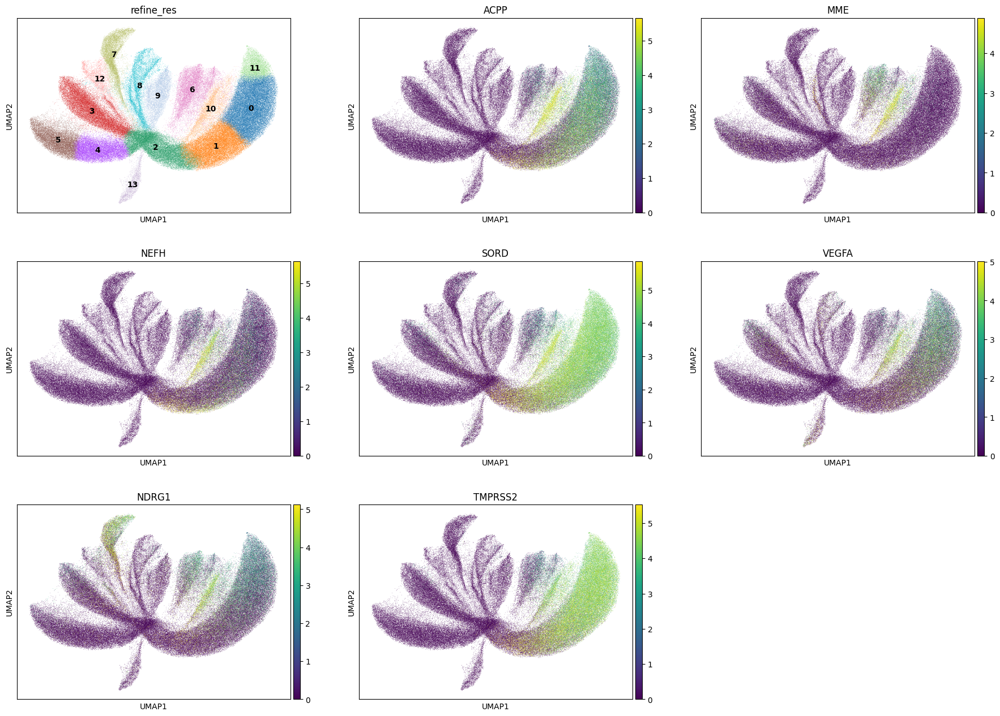

In [97]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [98]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 5806
Percentage of cells in cluster 10: 3.3


In [99]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Epithelial'

### 5.12. Cluster 11

In [100]:
cluster_id = '11'

In [101]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Prostate_epithelial_cancer_cell,cancer_cell,99.6
1,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,0.3
2,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,0.0
3,T,T,normal_cell,0.0
4,NA,NA,NA,0.0


In [102]:
top_ranked_genes[cluster_id]

0       DPP4
1    TMPRSS2
2      FOXA1
3      EEF1G
4      TRPM8
5     NKX3-1
6      AMACR
Name: 11, dtype: object

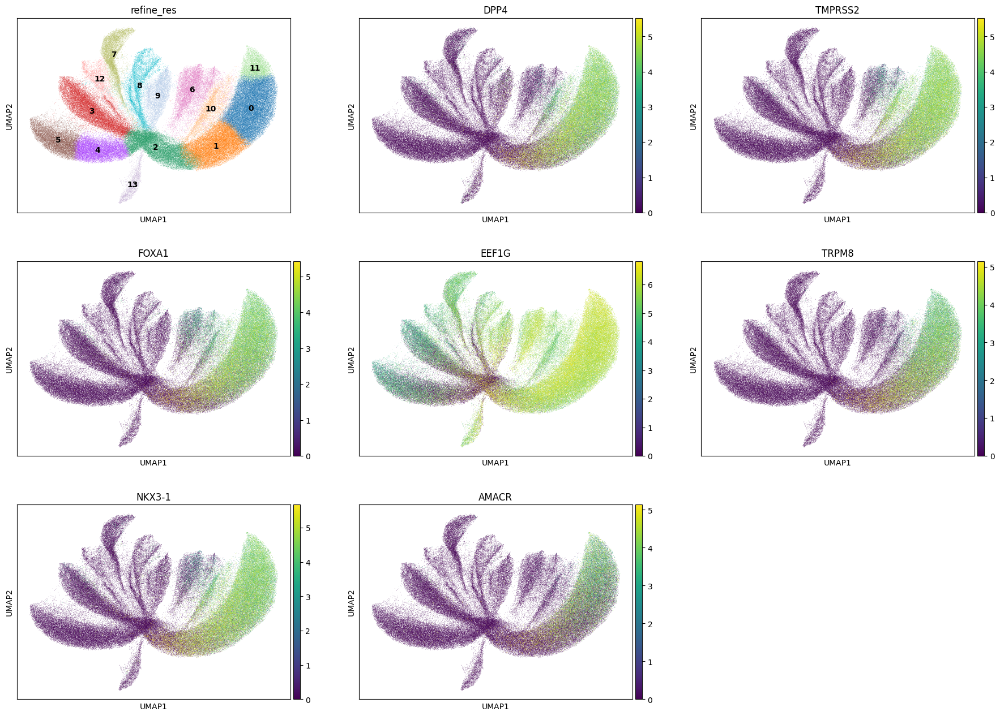

In [103]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [104]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 11: 5716
Percentage of cells in cluster 11: 3.2


In [105]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Epithelial'

### 5.13. Cluster 12

In [106]:
cluster_id = '12'

In [107]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Pericyte,Pericyte,normal_cell,79.8
1,Endothelial,Angiogenesis_endothelial_cell,normal_cell,5.8
2,Smooth_muscle,Smooth_muscle,normal_cell,4.1
3,Fibroblast,CAF,normal_cell,4.1
4,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,3.6


In [108]:
top_ranked_genes[cluster_id]

0    ADAMTS1
1     CDKN1A
2      EPAS1
3       RGS5
4     PDGFRB
5     NOTCH3
6    ADAMTS4
Name: 12, dtype: object

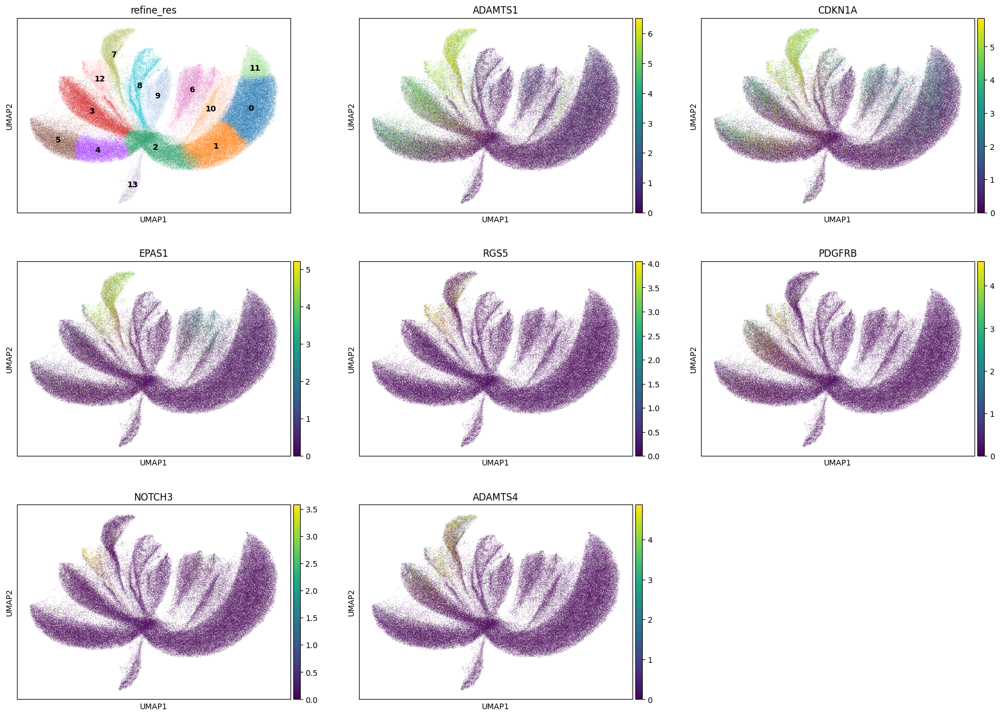

In [109]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [110]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 12: 3377
Percentage of cells in cluster 12: 1.9


In [111]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Pericyte'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Pericyte'

### 5.14. Cluster 13

In [112]:
cluster_id = '13'

In [113]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Mast,Mast,normal_cell,81.7
1,Cancer_cell_with_stem_like_properties,Prostate_cancer_cell_with_stem_like_properties,cancer_cell,7.4
2,NA,NA,NA,6.4
3,Fibroblast,CAF,normal_cell,1.9
4,Monocyte/Macrophage/DC,Monocyte/Macrophage/DC,normal_cell,1.1


In [114]:
top_ranked_genes[cluster_id]

0        KIT
1      MS4A2
2    SLC18A2
3     IL1RL1
4    SIGLEC6
5       CD44
6     SLC2A3
Name: 13, dtype: object

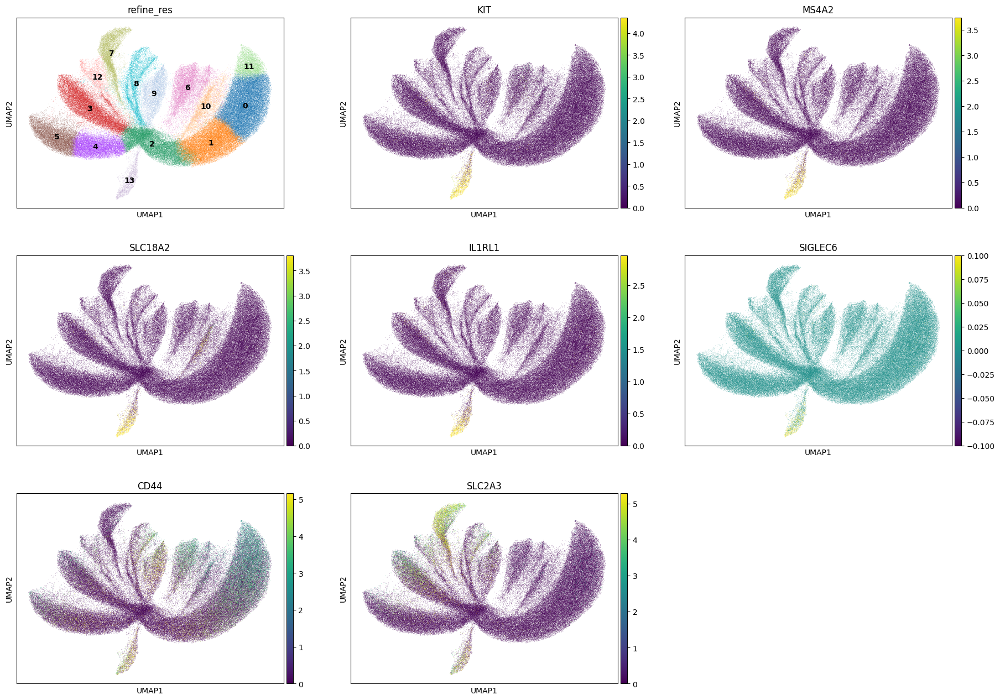

In [115]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [116]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 13: 2610
Percentage of cells in cluster 13: 1.5


In [117]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Mast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Mast'

## 6. Cancer cells

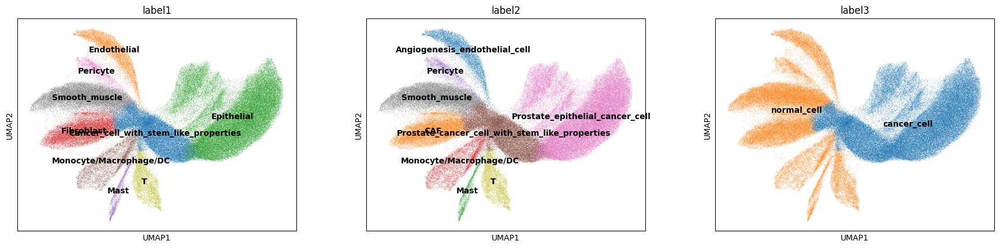

In [118]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

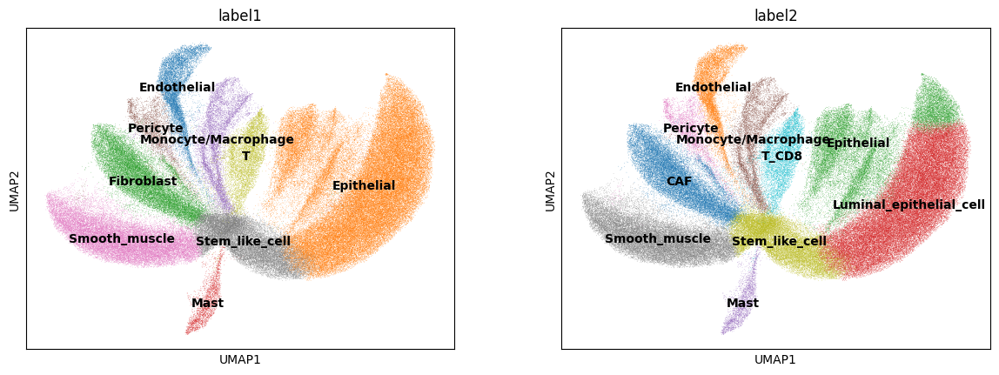

In [119]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [120]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'
adata_cells.obs.loc[adata_cells.obs['label1'].isin(['Epithelial', 'Stem_like_cell']), 'label3'] = 'cancer_cell'

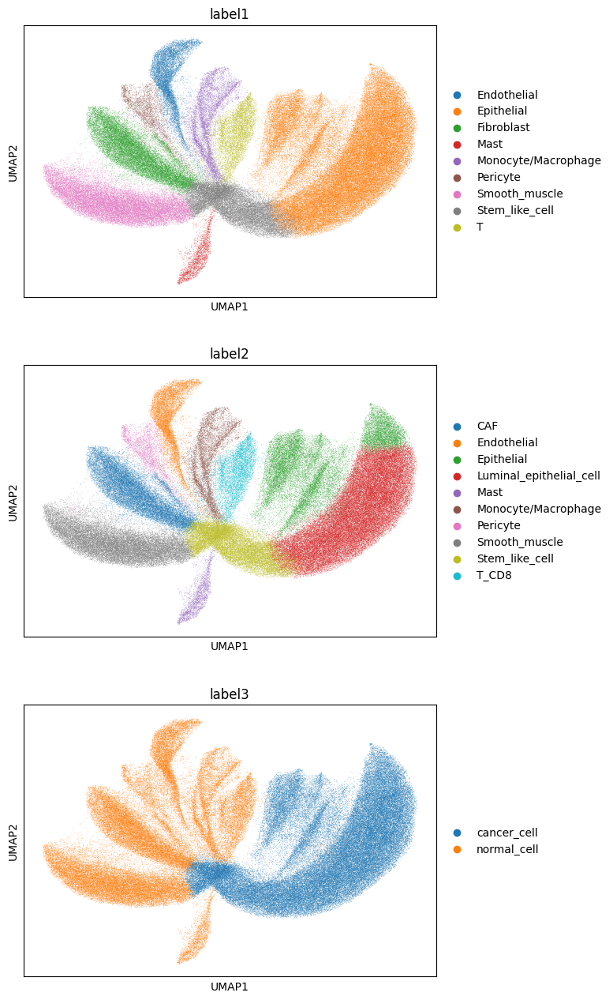

In [122]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [123]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,genomic_control_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,...,segmentation_method,region,z_level,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
1,aaaaaaaa-1,341,0,0,0,0,1,342,111.535942,50.484689,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,6,6,7,7,Endothelial,Endothelial,normal_cell
2,aaaaaaab-1,14,0,0,0,0,0,14,108.600785,18.875313,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,1,5,2,2,Stem_like_cell,Stem_like_cell,cancer_cell
3,aaaaaaac-1,45,0,0,0,0,0,45,56.309846,11.289063,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,2,2,4,4,Smooth_muscle,Smooth_muscle,normal_cell
4,aaaaaaad-1,99,0,0,0,0,0,99,41.543752,19.642969,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,4,9,9,9,T,T_CD8,normal_cell
7,aaaaaaae-1,40,0,0,0,0,0,40,26.100313,12.688907,...,Segmented by boundary stain (ATP1A1+CD45+E-Cad...,cell_labels,0.0,3,3,3,3,Fibroblast,CAF,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
192993,aaacncao-1,59,0,0,0,0,0,59,14.359688,14.359688,...,Segmented by nucleus expansion of 5.0µm,cell_labels,10.0,1,4,2,2,Stem_like_cell,Stem_like_cell,cancer_cell
192995,aaacncba-1,65,0,0,0,0,0,65,37.570001,13.501719,...,Segmented by nucleus expansion of 5.0µm,cell_labels,9.0,3,3,3,3,Fibroblast,CAF,normal_cell
192996,aaacncbb-1,30,0,0,0,0,0,30,9.573125,5.192969,...,Segmented by nucleus expansion of 5.0µm,cell_labels,10.0,2,5,4,4,Smooth_muscle,Smooth_muscle,normal_cell
192997,aaacncbc-1,139,0,0,0,0,0,139,99.117972,5.147813,...,Segmented by nucleus expansion of 5.0µm,cell_labels,10.0,2,2,5,5,Smooth_muscle,Smooth_muscle,normal_cell


In [124]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")